## Final Project Submission

Please fill out:
* Student name: Nagib Gonzalez
* Student pace: self paced 
* Scheduled project review date/time: 
* Instructor name: Morgan Jones
* Blog post URL:


# Business Problem:
Nimble Home Buyers, a real estate investment company, is seeking to expand their operations into the state of Washington. To support this endeavor, they have engaged the services of a data scientist to analyze King County housing data in order to identify the factors that influence home prices and the extent of their impact. This information will be instrumental in making informed decisions and successfully establishing a presence in the Washington market.
   
   ### Nimble Home Buyers Approach to Real Estate Investment:
  
  Nimble Home Buyers has an investment strategy that involves the identification and acquisition of properties, followed by renovation or new construction efforts and ultimately, the sale of these properties for a profit. This approach enables the company to optimize the value of their investments and generate returns for their stakeholders.

# Data Understanding 
### Column Names and Descriptions for King County Data Set
- `id` - Unique identifier for a house.
- `date` - Date house was sold.
- `price` - Sale price (prediction target).
- `bedrooms` - Number of bedrooms.
- `bathrooms` - Number of bathrooms.
- `sqft_living` - Square footage of living space in the home.
- `sqft_lot` - Square footage of the lot.
- `floors` - Number of floors (levels) in house.
- `waterfront` - Whether the house is on a waterfront. Includes Duwamish, Elliott Bay, Puget Sound, Lake Union, Ship Canal, Lake Washington, Lake Sammamish, other lake, and river/slough waterfronts.
- `view` - Quality of view from house. Includes views of Mt. Rainier, Olympics, Cascades, Territorial, Seattle Skyline, Puget Sound, Lake Washington, Lake Sammamish, small lake / river / creek, and other.
- `condition` - How good the overall condition of the house is. Related to maintenance of house.
See the King County Assessor Website for further explanation of each condition code.
- `grade` - Overall grade of the house. Related to the construction and design of the house.
See the King County Assessor Website for further explanation of each building grade code.
- `sqft_above` - Square footage of house apart from basement.
- `sqft_basement` - Square footage of the basement.
- `yr_built` - Year when house was built.
- `yr_renovated` - Year when house was renovated.
- `zipcode` - ZIP Code used by the United States Postal Service.
- `lat` - Latitude coordinate.
- `long` - Longitude coordinate.
- `sqft_living15` - The square footage of interior housing living space for the nearest 15 neighbors.
- `sqft_lot15` - The square footage of the land lots of the nearest 15 neighbors.
- `month_sold`- Month that the home was sold.
- `City`- City in which the home is located.

In [1]:
# Import libraries 
import plotly.express as px
import pandas as pd
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import numpy as np
import statsmodels.api as sm
from scipy import stats
import seaborn as sns
import statsmodels.stats.api as sms
import matplotlib.ticker as tick
import matplotlib.pyplot as plt
sns.set_theme(style="darkgrid")

# Load the csv file into a pandas dataframe
df = pd.read_csv("data/kc_house_data.csv")
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,10/13/2014,221900.0,3,1.00,1180,5650,1.0,NaN,NONE,...,7 Average,1180,0.0,1955,0.0,98178,47.5112,-122.257,1340,5650
1,6414100192,12/9/2014,538000.0,3,2.25,2570,7242,2.0,NO,NONE,...,7 Average,2170,400.0,1951,1991.0,98125,47.7210,-122.319,1690,7639
2,5631500400,2/25/2015,180000.0,2,1.00,770,10000,1.0,NO,NONE,...,6 Low Average,770,0.0,1933,NaN,98028,47.7379,-122.233,2720,8062
3,2487200875,12/9/2014,604000.0,4,3.00,1960,5000,1.0,NO,NONE,...,7 Average,1050,910.0,1965,0.0,98136,47.5208,-122.393,1360,5000
4,1954400510,2/18/2015,510000.0,3,2.00,1680,8080,1.0,NO,NONE,...,8 Good,1680,0.0,1987,0.0,98074,47.6168,-122.045,1800,7503


# Data Cleaning



In [2]:
# Investigating number of rows and columns

df.shape

(21597, 21)

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  object 
 9   view           21534 non-null  object 
 10  condition      21597 non-null  object 
 11  grade          21597 non-null  object 
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

It seems that there are columns that are stored as objects that should actually be numeric so we will be converting them. those columns include: waterfront, view, condition, grade and sqft_basement. The date column we will convert into a date time object.

For now we will be working with all of the columns except the Id column. The rows that seem to have missing data are, waterfront, view, and year renovated.  
# Missing Data

### Waterfront:
To handle missing values in the waterfront column, we will assume that the property does not have a waterfront view and fill the missing values with "NO".

### View:
To handle missing values in the view column, we will assume that the property has no view and fill the missing values with "0". Additionally, we will convert the values in this column from categorical to numerical for further analysis.

### Year Renovated:
To handle missing values in the year renovated column, we will assume that the property has not undergone any renovation since it was built. Therefore, we will add the year of construction to properties that do not have an official renovation date.

In [4]:
# removing Id column
df.drop('id', axis= 1, inplace= True)

In [5]:
# Check for missing values
df.isnull().sum()

date                0
price               0
bedrooms            0
bathrooms           0
sqft_living         0
sqft_lot            0
floors              0
waterfront       2376
view               63
condition           0
grade               0
sqft_above          0
sqft_basement       0
yr_built            0
yr_renovated     3842
zipcode             0
lat                 0
long                0
sqft_living15       0
sqft_lot15          0
dtype: int64

In [6]:
# Find the most common value
df.waterfront.value_counts()

NO     19075
YES      146
Name: waterfront, dtype: int64

In [7]:
# Replace the null values
df['waterfront'].fillna('NO', inplace= True)
df.waterfront.value_counts()

NO     21451
YES      146
Name: waterfront, dtype: int64

In [8]:
# Find the most common value
df.view.value_counts()

NONE         19422
AVERAGE        957
GOOD           508
FAIR           330
EXCELLENT      317
Name: view, dtype: int64

In [9]:
# Replacing NO and YES with 0 and 1 

df['waterfront'].replace({'NO': 0, 'YES': 1}, inplace=True)
df['waterfront'].value_counts()

0    21451
1      146
Name: waterfront, dtype: int64

In [10]:
# Investigating view value counts

df['view'].value_counts()

NONE         19422
AVERAGE        957
GOOD           508
FAIR           330
EXCELLENT      317
Name: view, dtype: int64

In [11]:
# Replacing view with numerical values

df['view'].replace(to_replace={'NONE': 0, 'FAIR': 1, 'AVERAGE': 2, 'GOOD': 3, 'EXCELLENT': 4}, inplace=True)

In [12]:
# Replacing Nan values with mode (NONE)

df['view'].fillna(df['view'].mode()[0], inplace=True)

In [13]:
#changing date to datetime object

df['date']=pd.to_datetime(df['date'])

In [14]:
# creating month sold column
df['month_sold'] = df['date'].dt.month_name()

In [15]:
df['yr_renovated'] = df['yr_renovated'].fillna(df['yr_built'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  float64       
 9   condition      21597 non-null  object        
 10  grade          21597 non-null  object        
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  object        
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  float64       
 15  zipcode        2159

In [17]:
# Replacing Nan values with mode (NONE)

df['yr_renovated'].fillna(df['yr_renovated'].mode()[0], inplace=True)

In [18]:

##retry the yr_renovated using .loc
condition  = (df['yr_renovated'] == 0 )
df.loc[condition, 'yr_renovated'] = df['yr_built']
df.head()


,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15,month_sold
0,2014-10-13,221900.0,3,1.00,1180,5650,1.0,0,0.0,Average,...,1180,0.0,1955,1955,98178,47.5112,-122.257,1340,5650,October
1,2014-12-09,538000.0,3,2.25,2570,7242,2.0,0,0.0,Average,...,2170,400.0,1951,1991,98125,47.7210,-122.319,1690,7639,December
2,2015-02-25,180000.0,2,1.00,770,10000,1.0,0,0.0,Average,...,770,0.0,1933,1933,98028,47.7379,-122.233,2720,8062,February
3,2014-12-09,604000.0,4,3.00,1960,5000,1.0,0,0.0,Very Good,...,1050,910.0,1965,1965,98136,47.5208,-122.393,1360,5000,December
4,2015-02-18,510000.0,3,2.00,1680,8080,1.0,0,0.0,Average,...,1680,0.0,1987,1987,98074,47.6168,-122.045,1800,7503,February


In [19]:
#making year built into a numeric object
df['yr_renovated'] = df['yr_renovated'].astype('int64')

In [20]:
#taking another look at our columnns
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  float64       
 9   condition      21597 non-null  object        
 10  grade          21597 non-null  object        
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  object        
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

In [21]:
# Investigating why sqft_basement is object Dtype

df['sqft_basement'].value_counts()

0.0       12826
?           454
600.0       217
500.0       209
700.0       208
          ...  
1920.0        1
3480.0        1
2730.0        1
2720.0        1
248.0         1
Name: sqft_basement, Length: 304, dtype: int64

**

In [22]:
#Replacing ? with 0.0

df['sqft_basement'].replace('?', 0, inplace=True)

In [23]:
# Changing sqft_basement Dtype

df['sqft_basement'] = df['sqft_basement'].astype(float).astype(int)

In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  float64       
 9   condition      21597 non-null  object        
 10  grade          21597 non-null  object        
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  int64         
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

In [25]:
# Investigating grade value counts

df['grade'].value_counts()

7 Average        8974
8 Good           6065
9 Better         2615
6 Low Average    2038
10 Very Good     1134
11 Excellent      399
5 Fair            242
12 Luxury          89
4 Low              27
13 Mansion         13
3 Poor              1
Name: grade, dtype: int64

In [26]:
# Replacing grade with numerical values

df['grade'].replace(to_replace= {'3 Poor': 3, '4 Low': 4, '5 Fair': 5, '6 Low Average': 6, '7 Average': 7,
                       '8 Good': 8, '9 Better': 9, '10 Very Good': 10, '11 Excellent': 11, '12 Luxury': 12, 
                        '13 Mansion': 13}, inplace = True)
df['grade'].value_counts()


7     8974
8     6065
9     2615
6     2038
10    1134
11     399
5      242
12      89
4       27
13      13
3        1
Name: grade, dtype: int64

In [27]:
# Investigating condition value counts
df['condition'].value_counts()

Average      14020
Good          5677
Very Good     1701
Fair           170
Poor            29
Name: condition, dtype: int64

In [28]:
# Replacing condition with numerical values
df['condition'].replace(to_replace= {'Poor': 0, 'Fair': 1, 'Average': 2,'Good':3, 'Very Good':4}, inplace = True)
df['condition'].value_counts()

2    14020
3     5677
4     1701
1      170
0       29
Name: condition, dtype: int64

In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  float64       
 9   condition      21597 non-null  int64         
 10  grade          21597 non-null  int64         
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  int64         
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

# Creating City Column: 
We will leverage the zipcode column in our data to create an additional column that indicates the city in which the property is located. To achieve this, we will utilize the Uszipcode library, which allows us to retrieve the city information by providing the zipcode. The following is the documentation for the library which we will use to perform this action.

https://uszipcode.readthedocs.io/index.html

In [30]:
# importing libbrary and creating function to return city based off zipcode.

import uszipcode
from uszipcode import SearchEngine
search = SearchEngine()

def zco(x):
    city = search.by_zipcode(x).major_city
    return city if city else 'None'

df['city'] = df['zipcode'].apply(zco)

/Users/a23/opt/anaconda3/lib/python3.8/site-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21597 non-null  datetime64[ns]
 1   price          21597 non-null  float64       
 2   bedrooms       21597 non-null  int64         
 3   bathrooms      21597 non-null  float64       
 4   sqft_living    21597 non-null  int64         
 5   sqft_lot       21597 non-null  int64         
 6   floors         21597 non-null  float64       
 7   waterfront     21597 non-null  int64         
 8   view           21597 non-null  float64       
 9   condition      21597 non-null  int64         
 10  grade          21597 non-null  int64         
 11  sqft_above     21597 non-null  int64         
 12  sqft_basement  21597 non-null  int64         
 13  yr_built       21597 non-null  int64         
 14  yr_renovated   21597 non-null  int64         
 15  zipcode        2159

In [32]:
#exploring City values
df['city'].value_counts()

Seattle          8973
Renton           1597
Bellevue         1407
Kent             1201
Kirkland          977
Redmond           977
Auburn            911
Sammamish         800
Federal Way       779
Issaquah          733
Maple Valley      589
Woodinville       471
Snoqualmie        308
Kenmore           283
Mercer Island     282
Enumclaw          233
North Bend        220
Bothell           195
Duvall            190
Carnation         124
Vashon            117
Black Diamond     100
Fall City          80
Medina             50
Name: city, dtype: int64

# Data Exploration

Now that we have cleaned our data lets take a look at the correlation price has with our other variables

In [33]:
df.corr()["price"].sort_values(ascending = False)

price            1.000000
sqft_living      0.701917
grade            0.667951
sqft_above       0.605368
sqft_living15    0.585241
bathrooms        0.525906
view             0.393497
sqft_basement    0.321108
bedrooms         0.308787
lat              0.306692
waterfront       0.264306
floors           0.256804
yr_renovated     0.097541
sqft_lot         0.089876
sqft_lot15       0.082845
yr_built         0.053953
condition        0.036056
long             0.022036
zipcode         -0.053402
Name: price, dtype: float64

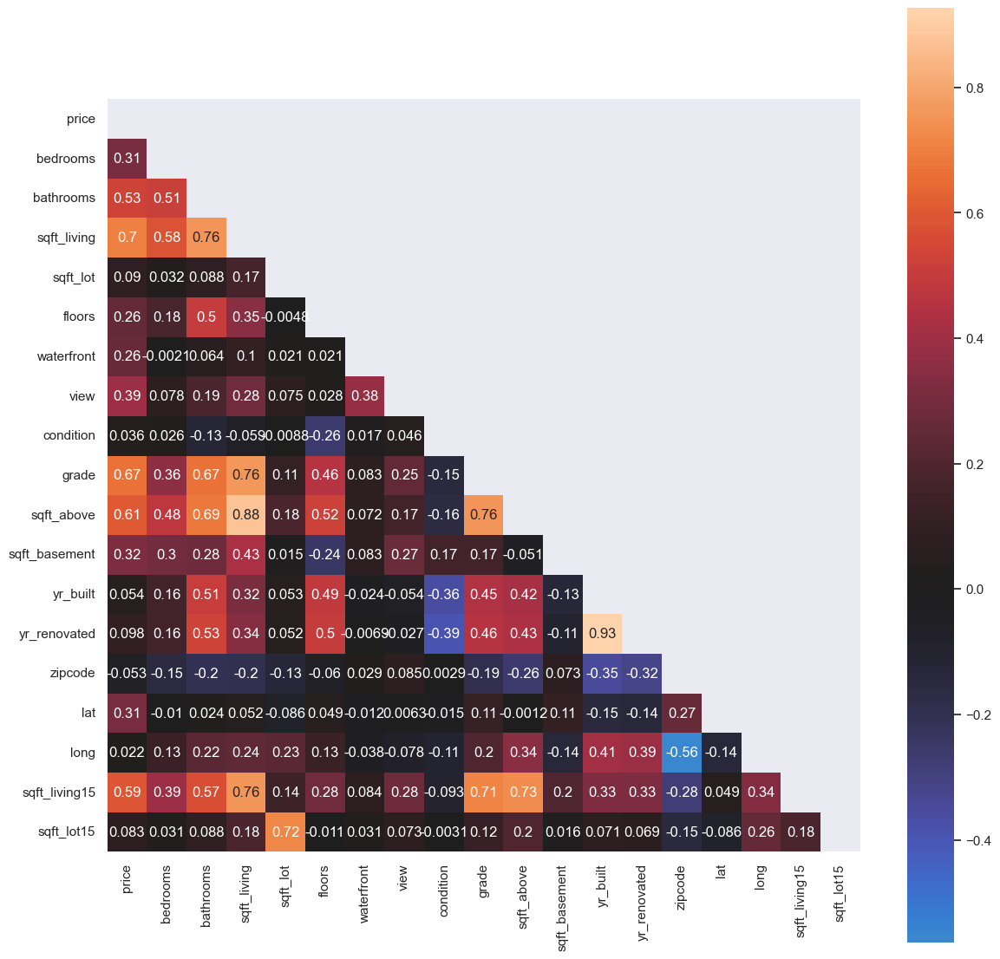

In [34]:
#Building correlation heatmap

fig, ax = plt.subplots(figsize=(14, 14))
ax = sns.heatmap(df.corr(), center=0, square=True, annot=True, mask=np.triu(np.ones_like(df.corr(), dtype=bool)))

In [35]:

# Turns large tick values (in the billions, millions and thousands) such as 4500 into 4.5K.

def reformat_large_tick_values(tick_val, pos):
    if tick_val >= 1000000:
        val = round(tick_val/1000000, 1)
        new_tick_format = '{:}M'.format(val)
    elif tick_val >= 1000:
        val = round(tick_val/1000, 1)
        new_tick_format = '{:}K'.format(val)
    elif tick_val < 1000:
        new_tick_format = round(tick_val, 1)
    else:
        new_tick_format = tick_val

    # make new_tick_format into a string value
    new_tick_format = str(new_tick_format)
    
    # code below will keep 4.5M as is but change values such as 4.0M to 4M since that zero after the decimal isn't needed
    index_of_decimal = new_tick_format.find(".")
    
    if index_of_decimal != -1:
        value_after_decimal = new_tick_format[index_of_decimal+1]
        if value_after_decimal == "0":
            # remove the 0 after the decimal point since it's not needed
            new_tick_format = new_tick_format[0:index_of_decimal] + new_tick_format[index_of_decimal+2:]
            
    return new_tick_format

# Code reference : https://dfrieds.com/data-visualizations/how-format-large-tick-values.html

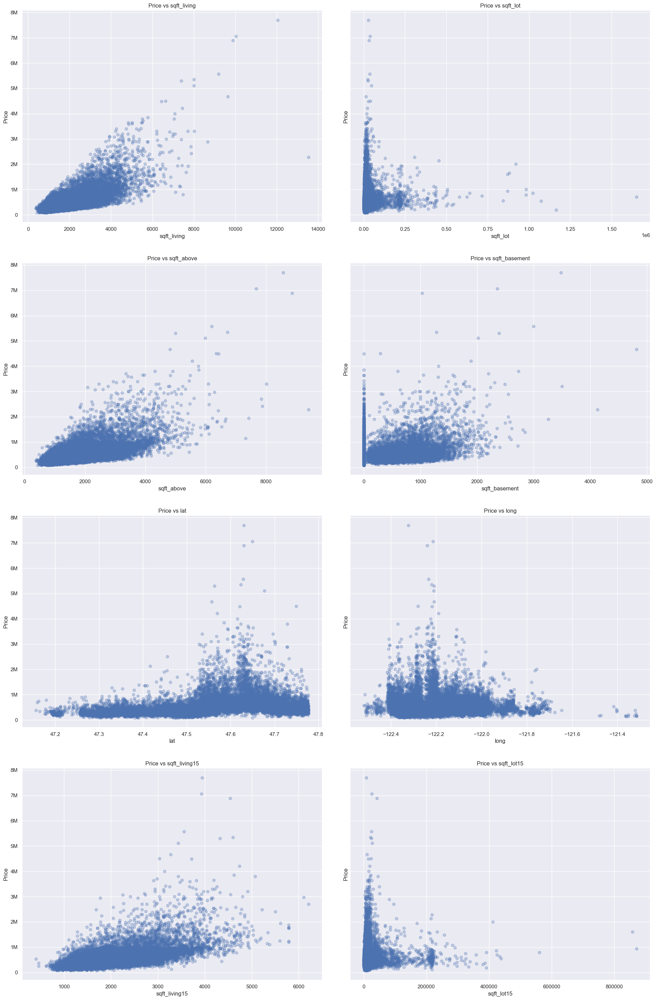

In [36]:
# Plotting scatter plots for all continuous features

continuous = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'lat', 'long', 'sqft_living15', 'sqft_lot15']
fig, axes = plt.subplots(4, 2, figsize=(20,30), sharey=True)
for ax, column in zip(axes.flatten(), df[continuous]):
    ax.scatter(df[column], df['price'], label=column, alpha=0.3)
    ax.set_title(f'Price vs {column}')
    ax.set_xlabel(column)
    ax.set_ylabel('Price')
    ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))
fig.tight_layout(pad=3.0)

# Scatterplot Observations

- sqft_basement has a significant amount of zero values. This is most likely because those homes did not have basements
- All of the sqft continous variables seem to have a linear relationship except sqft_lot15


In [37]:
#viewing house prices or outlier visualization 

fig =px.histogram(data_frame=df,x='price',title='House Prices in King County',marginal='box',histnorm='density')
print('Skewness:', df['price'].skew())
print('Kurtosis:', df['price']. kurt())
fig.show()

Skewness: 4.023364652271239
Kurtosis: 34.54135857673376


In [38]:
# Building a function to remove outliers

def removeOutliers(data, col):
    upper_range = np.quantile(data[col], 0.99)
    df.drop((df[df[col] > upper_range].index), inplace = True)

In [39]:
# Removing outliers in price column

removeOutliers(df, 'price')

In [40]:
# Plotting new price histogram

fig =px.histogram(data_frame=df,x='price',title='House Prices in King County',marginal='box',histnorm='density')
print('Skewness:', df['price'].skew())
print('Kurtosis:', df['price']. kurt())
fig.show()

Skewness: 1.7404854434423793
Kurtosis: 4.106726238973909


In [41]:
#below is another histogram of the price but with the count of houses instead of density

px.histogram(data_frame=df,x='price',title='House Prices in King County',marginal='box')

In [42]:
# Inspecting df after price outlier removal

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21383 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21383 non-null  datetime64[ns]
 1   price          21383 non-null  float64       
 2   bedrooms       21383 non-null  int64         
 3   bathrooms      21383 non-null  float64       
 4   sqft_living    21383 non-null  int64         
 5   sqft_lot       21383 non-null  int64         
 6   floors         21383 non-null  float64       
 7   waterfront     21383 non-null  int64         
 8   view           21383 non-null  float64       
 9   condition      21383 non-null  int64         
 10  grade          21383 non-null  int64         
 11  sqft_above     21383 non-null  int64         
 12  sqft_basement  21383 non-null  int64         
 13  yr_built       21383 non-null  int64         
 14  yr_renovated   21383 non-null  int64         
 15  zipcode        2138

In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21383 entries, 0 to 21596
Data columns (total 22 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   date           21383 non-null  datetime64[ns]
 1   price          21383 non-null  float64       
 2   bedrooms       21383 non-null  int64         
 3   bathrooms      21383 non-null  float64       
 4   sqft_living    21383 non-null  int64         
 5   sqft_lot       21383 non-null  int64         
 6   floors         21383 non-null  float64       
 7   waterfront     21383 non-null  int64         
 8   view           21383 non-null  float64       
 9   condition      21383 non-null  int64         
 10  grade          21383 non-null  int64         
 11  sqft_above     21383 non-null  int64         
 12  sqft_basement  21383 non-null  int64         
 13  yr_built       21383 non-null  int64         
 14  yr_renovated   21383 non-null  int64         
 15  zipcode        2138

# Plotting Sqft Parameters After Outlier Removal

In [44]:
fig = px.scatter(
    df, y='price', x='sqft_living', opacity=0.65,
    trendline='ols', trendline_color_override='darkblue',title='Price vs Living Square Feet')
fig.show()

In [45]:
fig = px.scatter(
    df, y='price', x='sqft_basement', opacity=0.65,
    trendline='ols', trendline_color_override='darkblue',title='Price vs Basement Square Feet')
fig.show()

In [46]:
fig = px.scatter(
    df, y='price', x='sqft_above', opacity=0.65,
    trendline='ols', trendline_color_override='darkblue',title='price vs above')
fig.show()

# Bathrooms

In [47]:

#Investigating bathroom value counts

df['bathrooms'].value_counts()

2.50    5358
1.00    3851
1.75    3046
2.25    2041
2.00    1929
1.50    1445
2.75    1180
3.00     735
3.50     710
3.25     555
3.75     141
4.00     115
4.50      87
0.75      71
4.25      59
5.00      16
4.75      10
1.25       9
5.25       9
0.50       4
5.50       4
5.75       3
6.00       2
6.75       1
7.50       1
6.50       1
Name: bathrooms, dtype: int64

In [48]:
# Viewing bathrooms boxplot 
fig = px.box(df,x='bathrooms',y='price',color='bathrooms',title='Home Sale Price vs. Bathrooms')
fig.show()

# Bedrooms

In [49]:

# Investigating bedrooms value counts
df['bedrooms'].value_counts()

3     9789
4     6786
2     2758
5     1540
6      259
1      196
7       33
8       11
9        6
10       3
11       1
33       1
Name: bedrooms, dtype: int64

In [50]:
# Removing bedroom outlier

df.drop((df[df['bedrooms']  > 10].index), inplace = True)

In [51]:
# Plotting boxplot for bedrooms
fig = px.box(df,x='bedrooms',y='price',color='bedrooms',title='Home Sale Price vs. Bedrooms')
fig.show()

# View

In [52]:
# Plotting boxplot for bedrooms
fig = px.box(df,x='view',y='price',color='view',title='Home Sale Price vs. View')
fig.show()

# Grade 

In [53]:

# Investigating grade value counts

df['grade'].value_counts()

7     8971
8     6059
9     2595
6     2038
10    1070
11     324
5      242
12      53
4       27
3        1
13       1
Name: grade, dtype: int64

In [54]:
#dropping outlier
df.drop((df[df['grade'] == 13].index), inplace = True)

In [55]:
# Plotting grade boxplot
fig = px.box(data_frame=df,x='grade',y='price',title='Home Sale Price vs. Grade',height=800,color='grade')
fig.update_xaxes(ticklabelstep=1)
fig.show()

# Floors

In [56]:
# Viewing floors value counts

df['floors'].value_counts()


1.0    10634
2.0     8094
1.5     1898
3.0      606
2.5      142
3.5        6
Name: floors, dtype: int64

In [57]:
# Plotting floors boxplot
fig = px.box(data_frame=df,x='floors',y='price',title='Home Sale Price vs. Floors',height=800,color='floors')
fig.show()

# Waterfront

In [58]:
fig = px.box(data_frame=df,x='waterfront',y='price',title='Home Sale Price vs. Waterfront',height=800,color='waterfront')
fig.show()

# Condition

In [59]:

df['condition'].value_counts()

2    13885
3     5629
4     1668
1      169
0       29
Name: condition, dtype: int64

In [100]:
# Plotting condditioon boxplot


fig = px.box(data_frame=df,x='condition', y='price',title='Home Sale Price vs. Condition',color='condition')
fig.show()

# Month Sold

In [62]:
#Sorting month sold in order. It seems that the data. is reccorded from May 2014- April 2015

datedf = df.sort_values(by='date',axis=0,ascending=True)

In [63]:
fig = px.box(datedf,x='month_sold',y='price')
fig.show()

In [64]:
fig = px.histogram(datedf,x='month_sold',y='price',histfunc='avg',nbins=8, text_auto=True,title='Average Home Price Per Month')
fig.show()

# Year built and Renovated
Each bar represents a decade starting from 1900-1909

In [65]:
fig = px.histogram(df,x='yr_built',y='price',histfunc='avg',nbins=20, text_auto=True,title='Average Home Price Vs Year Built In Decades')

fig.update_layout(bargap=0.2)
fig.update_xaxes(nticks=20)
fig.show()

In [66]:


fig = px.histogram(data_frame=df,x='yr_renovated', y='price',title='Average of Home Sale Price vs. Year Renovated In Decades',histfunc='avg',nbins=20, text_auto=True)
fig.update_layout(bargap=0.2)
fig.update_xaxes(nticks=20)
fig.show()

# Lattitude and Longitude

In [139]:

px.set_mapbox_access_token(open("mapbox_token").read())
fig = px.scatter_mapbox(data_frame=df,lat='lat',lon='long',color='price',opacity=0.7,  hover_name='city',
color_continuous_scale=px.colors.cyclical.Edge, size_max=15, zoom=8,title='Home Prices Across King County')

fig.update_traces(textposition='top center', selector=dict(type='scattermapbox'))
fig.show()

# City

In [132]:
fig = px.histogram(data_frame=df,x='city', y='price',title='Average Home Sale Price vs. City',histfunc='avg', text_auto=True,)
fig.update_layout(bargap=0.2,xaxis={'categoryorder':'total ascending'})
fig.update_yaxes(automargin=True,)
fig.update_xaxes(automargin=True,tickangle=45)
fig.show()

In [130]:
fig = px.box(data_frame=df,x='city', y='price',title='Average of Home Sale Price vs. City',)
fig.update_layout(bargap=0.2)
fig.update_xaxes(type='category',tickangle=45)

fig.update_layout(xaxis={'categoryorder':'mean ascending'})
fig.show()


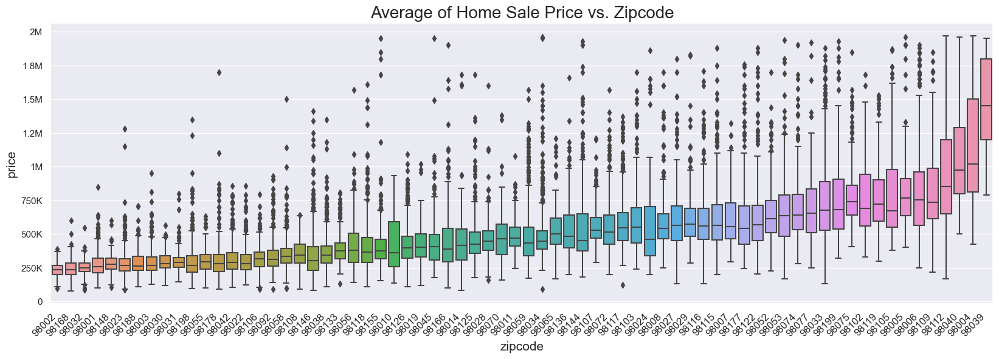

In [70]:
# Sort zipcodes by mean prices 
# Assign zipcode and price to a new variable
price_zip_df = df[['zipcode','price']].copy()

# Group by 'zipcode' and aggregate the mean
tmp = price_zip_df.groupby('zipcode')['price'].agg('mean')

# Sort by mean values and reset index 
tmp = tmp.sort_values().reset_index().reset_index()

# Convert zipcodes to ranking of their mean value 
price_zip_df.zipcode = price_zip_df.zipcode.apply(lambda x: int(tmp[tmp.zipcode==x]['index']))

# Plot zipcode bins 
fig, ax = plt.subplots(figsize=(20,6))
sns.boxplot(x=price_zip_df.zipcode,y=price_zip_df.price, ax=ax)

# Reduce fontsize and rotate xtick for readability 
ax.set_xticklabels(ax.get_xmajorticklabels(),fontsize=12,rotation=45,ha='right');

# Rename ticks to match with zipcodes 
plt.xticks(ax.get_xticks(), tmp.zipcode)

# Adjust font sizes 
ax.set_title('Average of Home Sale Price vs. Zipcode', fontsize=20)
ax.set_xlabel('zipcode',fontsize=15)
ax.set_ylabel('price',fontsize=15);

#format price to show in thousands
ax.yaxis.set_major_formatter(tick.FuncFormatter(reformat_large_tick_values))



In [131]:
# Same box plot as above but is interactive

fig = px.box(data_frame=df,x='zipcode', y='price',title='Average of Home Sale Price vs. Zipcode',color='zipcode',)
fig.update_layout(bargap=0.2)
fig.update_xaxes(type='category',ticklabelstep=1,tickangle=45)
fig.update_layout(xaxis={'categoryorder':'mean ascending'})
fig.show()

### Lets finish cleaning our data so it can ready to be put into our model. 

 
 

In [72]:
#convert "month_sold" months to numbers column to dummy variable and dropping date
features_df = df
features_df['month_sold'].replace(to_replace= {'January': 1, 'February': 2, 'March': 3, 'April': 4, 'May': 5,
                       'June': 6, 'July': 7, 'August': 8, 'September': 9, 'October': 10, 
                        'November': 11, 'December': 12}, inplace = True)

features_df['month_sold']= pd.to_numeric(features_df['month_sold'])

features_df['date'] = features_df['date'].astype('int')

In [73]:
# One hot encoding our City column using the get dummy method and dropping the City column

dummy_df = pd.get_dummies(features_df['city'])
features_df = pd.concat([features_df, dummy_df], axis=1)
features_df.drop('city',axis=1,inplace=True)

# Modeling:
Now that our data is ready, we will be using the ordinary least squares (OLS) method.

### What is Ordinary Least Squares (OLS)?
The ordinary least squares (OLS) method is a widely used technique for estimating the parameters of a linear regression model. The OLS formula is used to find the values of the model's parameters that minimize the sum of the squared differences between the predicted values and the actual values of the response variable.

The OLS formula for a simple linear regression model with one predictor variable is:

$ \hat{\beta} = (X^TX)^{-1}X^TY $

Where:

- $\hat{\beta}$ represents the vector of estimated parameters for the model (i.e., the coefficients of the predictor variable and the constant term).
- $X$ represents the matrix of predictor variable values (with an added column of 1s for the constant term).
- $Y$ represents the vector of actual values of the response variable.
- $X^T$ represents the transpose of the matrix X.

For multiple linear regression with multiple predictor variables, the formula is slightly different:

$ \hat{\beta} = (X^TX)^{-1}X^TY $

Where:

- $\hat{\beta}$ represents the vector of estimated parameters for the model (i.e., the coefficients of the predictor variables and the constant term).
- $X$ represents the matrix of predictor variable values (with an added column of 1s for the constant term).
- $Y$ represents the vector of actual values of the response variable.
- $X^T$ represents the transpose of the matrix X.
- $X^TX$ is the matrix of cross-products of X.






# Measuring Sucess
To measure our model results using R-Squared and Adjusted R-Squared, Linearity, Normality, Homoscedasticity, F-statistic and p-values.

### What is R-Squared?

R-squared is a statistical measure that is commonly used to evaluate the performance of a model. It is a value between 0 and 1, with a higher value indicating a better fit of the model to the data. Here are a few reasons why R-squared is often used to evaluate models:

1. It is easy to interpret: R-squared is a simple and intuitive metric that can be easily understood by both technical and non-technical stakeholders. A high R-squared value indicates that the model is able to explain a large proportion of the variation in the data, while a low value indicates that the model is not able to explain much of the variation.

2. It can be used to compare models: R-squared can be used to compare the performance of different models, making it easy to determine which model is the best fit for the data.

3. It can be used to evaluate the importance of predictors: R-squared can also be used to evaluate the importance of individual predictors in the model by comparing the R-squared value for a model with one predictor to a model with multiple predictors.

4. It is widely used in the field: R-squared is a well-established metric in statistics and is widely used in various fields such as finance, economics, and marketing.

The R-Sqaured **formula** is: $$ R^2 =  \frac{\sum_{i=1}^n (\hat{y_i}-\bar{y})^2}{\sum_{i=1}^n (y_i-\bar{y})^2} $$

- $\hat{y_i}$ represents the predicted value of the response variable for the ith observation.

- $\bar{y}$ represents the mean of the response variable.

- $n$ is the number of observations in the data set.

### What is Adjusted R- Squared?
Adjusted R-squared is also a value between 0 and 1, but it is adjusted for the number of predictors in the model. It is calculated by taking into account the number of predictors and the sample size, and it penalizes models that have a large number of predictors but do not improve the fit of the model. A higher adjusted R-squared value indicates that the model is a better fit to the data, taking into account the number of predictors.

The Adjusted R-Sqaured **formula** is: $ adj-R^2 = 1 - (1-R^2)\frac{n-1}{n-k-1} $

- $n$ is the number of observations in the data set.

- $k$ is the number of predictors in the model.

### What is the Difference ?

In summary, R-squared measures the proportion of variation in the response variable that is explained by the model, while adjusted R-squared takes into account the number of predictors in the model and penalizes models with a large number of predictors that do not improve the fit of the model. Therefore, adjusted R-squared is a more robust measure than R-squared, especially when you have a large number of predictors in your model, and it's a better indicator of how well the model fits the data.

### Linearity

Linearity is a key assumption in linear regression, it refers to the relationship between the predictor variables and the response variable being linear. A linear relationship means that the change in the response variable is proportional to the change in the predictor variable. In other words, a linear relationship means that the response variable can be modeled as a straight line.

Linearity can be represented by the equation of a line, which is Y = a + bX, where Y is the response variable, X is the predictor variable, a is the y-intercept, and b is the slope. The slope represents the rate of change in Y for a unit change in X.

For example, if the predictor variable is square footage of living space and the response variable is price, a linear relationship would mean that the price of a property is directly proportional to the square footage of living space. In this case, the price of a property would increase as the square footage of living space increases.

Linearity is an important assumption because linear regression models are based on the assumption that the relationship between the predictor variable and the response variable is linear, if the relationship is not linear, the predictions of the model may not be accurate. A violation of linearity can occur when the relationship between the predictor variable and the response variable is non-linear, such as quadratic or exponential. In these cases, non-linear regression models or other advanced methods such as polynomial regression, log transformation, or spline regression, may be more appropriate.


### Normality 
Normality is another key assumption in linear regression, which refers to the distribution of the residuals (the difference between the observed and predicted values) being normal. Normality means that the residuals have a bell-shaped distribution and are symmetric around zero. The normal distribution is also known as the Gaussian distribution or the bell curve.

The normality assumption is important because many statistical tests and confidence intervals rely on the residuals being normally distributed. If the residuals are not normally distributed, the results of the tests and intervals may not be valid. Additionally, if the residuals are not normally distributed, it may indicate that the model is not a good fit for the data, or that some important predictor variables are missing from the model.

There are several ways to check the normality of residuals, including visualizing the residuals using a histogram or a normal probability plot, and using statistical tests such as the Anderson-Darling test, the Shapiro-Wilk test, or the Kolmogorov-Smirnov test.  we will bbe using a  Q-Q plot

A Q-Q plot, also known as a quantile-quantile plot, is a graphical technique used to check the normality of a set of data. It is a scatter plot that compares the distribution of the data to a normal distribution.

To create a Q-Q plot, the data is first sorted in ascending order. Then, for each value in the data, the corresponding quantile from a normal distribution is calculated. The x-axis of the Q-Q plot represents the expected values from the normal distribution and the y-axis represents the observed values from the data.

A Q-Q plot can be used to visually inspect if the data follows a normal distribution or not. If the data is normally distributed, the points in the Q-Q plot will form a straight line, this is because the distribution of the data is similar to the distribution of the normal distribution. If the data is not normally distributed, the points will not form a straight line. For example, if the data is skewed the points will deviate from the straight line.

A Q-Q plot can also be used to identify any outliers in the data. Outliers are values that are far away from the straight line in the Q-Q plot.

### Homoscedasticity

Homoscedasticity, also known as homogeneity of variances, is an assumption in linear regression that states that the variance of the residuals is constant across all levels of the predictor variables. In other words, the spread of the residuals is the same for all predicted values.

Homoscedasticity is important because it ensures that the model's error term has constant variance, which makes it possible to use standard statistical techniques for estimating and testing model parameters. If the assumption of homoscedasticity is not met, the model's error term has non-constant variance, which can lead to biased parameter estimates and invalid hypothesis tests.

To check for homoscedasticity we will do a visual Inspection  and Goldfeld-Quandt test  Scatter plots of residuals against predicted values can be used to check for homoscedasticity. If the residuals are homoscedastic, the scatter plot will show a random pattern, if the residuals are heteroscedastic, the scatter plot will show a funnel shape, with the spread of the residuals increasing or decreasing as the predicted values increase.


The Goldfeld-Quandt test is a statistical test used to check for heteroscedasticity, which is the violation of the assumption of homoscedasticity. The test is named after its creators, E.Goldfeld and R.E. Quandt.

The test works by dividing the data into two or more subsets and then comparing the variance of the residuals in each subset. The null hypothesis of the test is that the variances of the residuals are the same across all subsets, while the alternative hypothesis is that the variances are different across subsets.

The test statistic is calculated as the ratio of the largest variance to the smallest variance of the residuals in each subset. The test statistic is then compared to a critical value from a chi-squared distribution. If the test statistic is greater than the critical value, the null hypothesis of equal variances is rejected, and it is concluded that the data is heteroscedastic.

The Goldfeld-Quandt test is considered as a robust test for heteroscedasticity, and it can be used in both simple and multiple linear regression models.

### F-Statistic and p- Values:
The F-statistic and p-value are used in hypothesis testing to determine whether there is a significant relationship between a predictor variable and a response variable in a linear regression model.

The F-statistic is a ratio of two variances. It compares the explained variation of the model to the unexplained variation. In other words, it compares the variance of the predicted values to the variance of the residuals (the difference between the actual and predicted values). The F-statistic is calculated by dividing the mean squared explained variation by the mean squared residual.

The p-value is the probability that the F-statistic would be equal to or greater than the observed F-statistic, assuming that the null hypothesis is true. The null hypothesis in this case is that there is no relationship between the predictor variable and the response variable (i.e., all the coefficients in the model are equal to zero). A small p-value (typically less than 0.05) indicates that it is unlikely that the observed F-statistic occurred by chance, and thus, we can reject the null hypothesis and conclude that there is a significant relationship between the predictor variable and the response variable.

The F-statistic and p-value are closely related and are used together to test the overall significance of the model. The F-statistic measures how much the model is better than a null model that has no predictors, while the p-value gives the probability of observing such a large F-statistic by chance, if the null model is true.









In [74]:
features_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21380 entries, 0 to 21596
Data columns (total 45 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   date           21380 non-null  int64  
 1   price          21380 non-null  float64
 2   bedrooms       21380 non-null  int64  
 3   bathrooms      21380 non-null  float64
 4   sqft_living    21380 non-null  int64  
 5   sqft_lot       21380 non-null  int64  
 6   floors         21380 non-null  float64
 7   waterfront     21380 non-null  int64  
 8   view           21380 non-null  float64
 9   condition      21380 non-null  int64  
 10  grade          21380 non-null  int64  
 11  sqft_above     21380 non-null  int64  
 12  sqft_basement  21380 non-null  int64  
 13  yr_built       21380 non-null  int64  
 14  yr_renovated   21380 non-null  int64  
 15  zipcode        21380 non-null  int64  
 16  lat            21380 non-null  float64
 17  long           21380 non-null  float64
 18  sqft_l

In [75]:

features_df.head()


,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,...,Medina,Mercer Island,North Bend,Redmond,Renton,Sammamish,Seattle,Snoqualmie,Vashon,Woodinville
0,1413158400000000000,221900.0,3,1.00,1180,5650,1.0,0,0.0,2,...,0,0,0,0,0,0,1,0,0,0
1,1418083200000000000,538000.0,3,2.25,2570,7242,2.0,0,0.0,2,...,0,0,0,0,0,0,1,0,0,0
2,1424822400000000000,180000.0,2,1.00,770,10000,1.0,0,0.0,2,...,0,0,0,0,0,0,0,0,0,0
3,1418083200000000000,604000.0,4,3.00,1960,5000,1.0,0,0.0,4,...,0,0,0,0,0,0,1,0,0,0
4,1424217600000000000,510000.0,3,2.00,1680,8080,1.0,0,0.0,2,...,0,0,0,0,0,1,0,0,0,0


In [76]:

features_corrs = features_df.corr()['price'].map(abs).sort_values(ascending = False)
features_corrs.head(12)

price            1.000000
grade            0.680215
sqft_living      0.678715
sqft_living15    0.601944
sqft_above       0.583676
bathrooms        0.507924
lat              0.364418
view             0.343441
bedrooms         0.324123
sqft_basement    0.282147
floors           0.278993
Bellevue         0.271695
Name: price, dtype: float64

# Baseline Model: 
 Our baselne model will include 'sqft_living' as our only variable.

In [77]:
# Creating our baseline model with grade as the only feature

from statsmodels.tools.tools import add_constant

y_target = features_df['price']
X_baseline = features_df['sqft_living']


Xc = add_constant(X_baseline)
model = sm.OLS(y_target, Xc).fit()
model.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.461
Model:                            OLS   Adj. R-squared:                  0.461
Method:                 Least Squares   F-statistic:                 1.826e+04
Date:                Tue, 17 Jan 2023   Prob (F-statistic):               0.00
Time:                        13:36:14   Log-Likelihood:            -2.9229e+05
No. Observations:               21380   AIC:                         5.846e+05
Df Residuals:                   21378   BIC:                         5.846e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===============================================================================
                  coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------
const        5.747e+04   3699.882     15.533      0.000    5.02e+04    6.47e+04
sqft_living   224.7474      1.663    135.126      0.000     221.487     228.008
==============================================================================
Omnibus:                     5163.845   Durbin-Watson:                   1.969
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            16524.201
Skew:                           1.227   Prob(JB):                         0.00
Kurtosis:                       6.539   Cond. No.                     5.75e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 5.75e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Linearity

In [78]:
y_preds = model.predict(Xc)

fig = px.scatter(x=y_target, y=y_preds , labels={'x': 'Actaual Price', 'y': 'Prediction Price'})
fig.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y_target.min(), y0=y_target.min(),
    x1=y_target.max(), y1=y_target.max()
)
fig.show()

 looking at the scatter plot above, we can say that our baseline model **passes** the linearity assumption.

# Normality Check

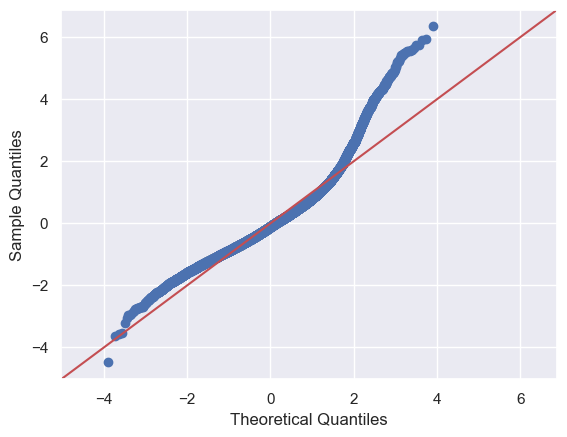

In [79]:

residuals = (y_target - y_preds)
sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True);

After observing the Q-Q plot above, our baseline model **does not pass** the normality assumption.

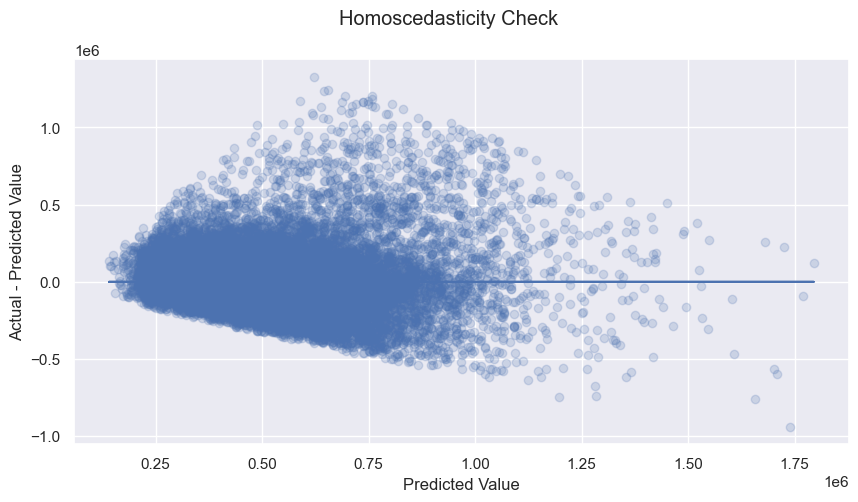

In [80]:

residuals = model.resid
fig, ax = plt.subplots(figsize=(10,5))
fig.suptitle('Homoscedasticity Check')
ax.scatter(y_preds, residuals, alpha=0.2)
ax.plot(y_preds, [0 for i in range(len(Xc))])
ax.set_xlabel("Predicted Value")
ax.set_ylabel("Actual - Predicted Value");

In [81]:
name = ['F statistic', 'p-value']
test = sms.het_goldfeldquandt(y_target, Xc)
list(zip(name, test))

[('F statistic', 1.0277983041481003), ('p-value', 0.07820227690846991)]

Based on the observation of the plot above and the Goldfeld-Quandt test (p-value of 0.07) the baseline model **does not pass** the homoscedasticity assumption.

# Model 2
Our second model will include all features in our dataframe. The perfomance of this model dropped significantly with an R-Squared and Adjusted R-Squared of .010. It is possible that the date column is responsible for this for our next model we will drop the columnn to see if there is a significant difference.

In [82]:
# Creating Model 2 including all selected features

y_target = features_df['price']
X_features = features_df.drop('price', axis=1)


Xc = add_constant(X_features)
model2 = sm.OLS(y_target, Xc).fit()
model2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     109.0
Date:                Tue, 17 Jan 2023   Prob (F-statistic):           7.89e-48
Time:                        13:36:16   Log-Likelihood:            -2.9878e+05
No. Observations:               21380   AIC:                         5.976e+05
Df Residuals:                   21377   BIC:                         5.976e+05
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          1.376e-09   3.51e-08      0.039      0.969   -6.75e-08    7.02e-08
date           3.577e-13   1.52e-15    235.993      0.000    3.55e-13    3.61e-13
bedrooms       4.461e-07    3.6e-08     12.393      0.000    3.76e-07    5.17e-07
bathrooms      9.913e-07   1.03e-07      9.661      0.000     7.9e-07    1.19e-06
sqft_living       0.0025      0.000      7.570      0.000       0.002       0.003
sqft_lot          0.4993      0.068      7.388      0.000       0.367       0.632
floors        -9.583e-08   3.32e-08     -2.886      0.004   -1.61e-07   -3.07e-08
waterfront     2.786e-08   7.27e-09      3.834      0.000    1.36e-08    4.21e-08
view            8.08e-07   6.95e-08     11.625      0.000    6.72e-07    9.44e-07
condition     -3.275e-08   2.93e-08     -1.117      0.264   -9.02e-08    2.47e-08
grade          2.049e-06    2.7e-07      7.584      0.000    1.52e-06    2.58e-06
sqft_above        0.0024      0.000      7.661      0.000       0.002       0.003
sqft_basement  8.048e-05   1.06e-05      7.590      0.000    5.97e-05       0.000
yr_built       2.973e-05   7.62e-06      3.902      0.000    1.48e-05    4.47e-05
yr_renovated   2.869e-05   7.38e-06      3.888      0.000    1.42e-05    4.32e-05
zipcode          -0.0001   1.05e-05    -11.310      0.000      -0.000   -9.81e-05
lat           -1.891e-07   1.32e-08    -14.353      0.000   -2.15e-07   -1.63e-07
long           5.443e-07   5.78e-08      9.422      0.000    4.31e-07    6.58e-07
sqft_living15     0.0018      0.000      4.719      0.000       0.001       0.003
sqft_lot15        0.3927      0.102      3.854      0.000       0.193       0.592
month_sold     1.783e-07   1.84e-07      0.970      0.332   -1.82e-07    5.39e-07
Auburn         1.132e-07   3.25e-08      3.488      0.000    4.96e-08    1.77e-07
Bellevue      -2.979e-08   1.13e-08     -2.625      0.009    -5.2e-08   -7.54e-09
Black Diamond  8.859e-08   2.03e-08      4.364      0.000    4.88e-08    1.28e-07
Bothell        -1.56e-08   3.53e-09     -4.419      0.000   -2.25e-08   -8.68e-09
Carnation      2.078e-07   3.95e-08      5.263      0.000     1.3e-07    2.85e-07
Duvall         1.139e-07   3.21e-08      3.549      0.000     5.1e-08    1.77e-07
Enumclaw       2.427e-07   2.44e-08      9.943      0.000    1.95e-07     2.9e-07
Fall City      1.385e-07   2.33e-08      5.931      0.000    9.27e-08    1.84e-07
Federal Way    -6.16e-08   6.36e-09     -9.686      0.000   -7.41e-08   -4.91e-08
Issaquah       1.148e-07   2.73e-08      4.202      0.000    6.13e-08    1.68e-07
Kenmore       -1.841e-08   3.94e-09     -4.669      0.000   -2.61e-08   -1.07e-08
Kent          -3.087e-08   2.48e-08     -1.244      0.213   -7.95e-08    1.78e-08
Kirkland      -9.382e-08   1.38e-08     -6.787      0.000   -1.21e-07   -6.67e-08
Maple Valley   1.146e-07   1.55e-08      7.384   

# Linearity

In [83]:
y_preds = model2.predict(Xc)

fig = px.scatter(x=y_target, y=y_preds , labels={'x': 'Actaual Price', 'y': 'Prediction Price'})
fig.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y_target.min(), y0=y_target.min(),
    x1=y_target.max(), y1=y_target.max()
)
fig.show()

Model 2 **does not pass** the linearity assumption.

# Normality Check

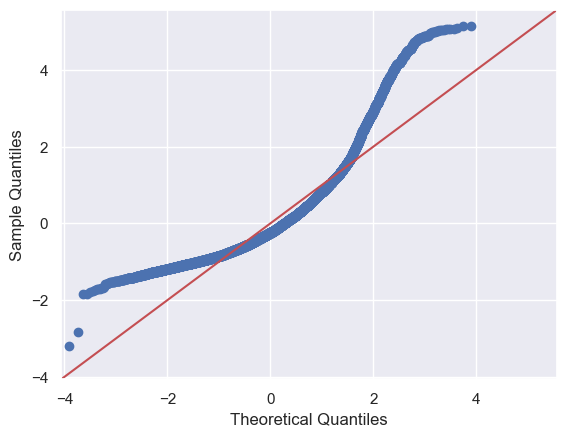

In [84]:
residuals = (y_target - y_preds)
sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True);

Model 2 **does not pass** the normality assumption.

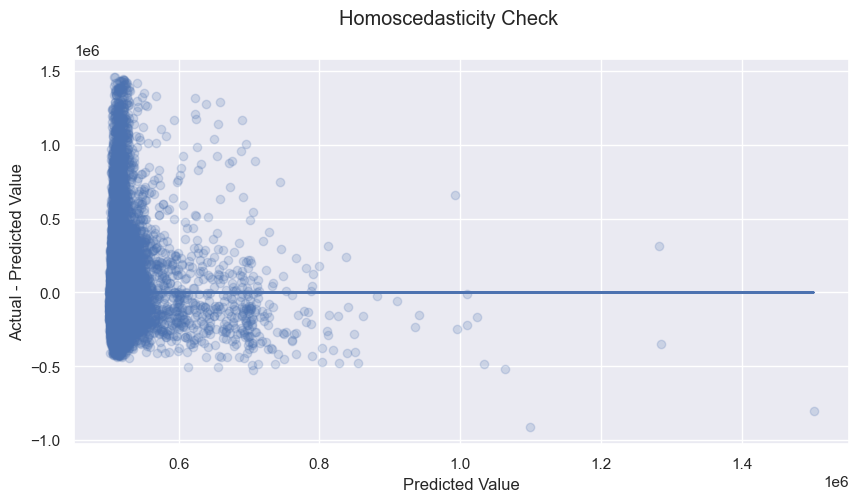

In [85]:
residuals = model2.resid
fig, ax = plt.subplots(figsize=(10,5))
fig.suptitle('Homoscedasticity Check')
ax.scatter(y_preds, residuals, alpha=0.2)
ax.plot(y_preds, [0 for i in range(len(Xc))])
ax.set_xlabel("Predicted Value")
ax.set_ylabel("Actual - Predicted Value");

In [86]:
name = ['F statistic', 'p-value']
test = sms.het_goldfeldquandt(y_target, Xc)
list(zip(name, test))


[('F statistic', 1.1029900044435246), ('p-value', 2.0349091081237516e-07)]

Based on the observation of the plot above and the Goldfeld-Quandt test (p-value of 0.00000020349091081237516) the baseline model **does pass** the homoscedasticity assumption.

# Model 3 
for this third model we will be dropping the date column to see if it improves our model performance. As predicted it actually did improve our performance and we goot an R-squared of 0.773.

In [87]:
#dropping date column
features_df.drop(columns=['date'],axis=1,inplace=True)

In [88]:
# Creating Model 3 
y_target = features_df['price']
X_features = features_df.drop('price', axis=1)


Xc = add_constant(X_features)
model3 = sm.OLS(y_target, Xc).fit()
model3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.773
Model:                            OLS   Adj. R-squared:                  0.773
Method:                 Least Squares   F-statistic:                     1732.
Date:                Tue, 17 Jan 2023   Prob (F-statistic):               0.00
Time:                        13:36:17   Log-Likelihood:            -2.8303e+05
No. Observations:               21380   AIC:                         5.661e+05
Df Residuals:                   21337   BIC:                         5.665e+05
Df Model:                          42                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const          6.246e+07   5.74e+06     10.886      0.000    5.12e+07    7.37e+07
bedrooms      -1.864e+04   1369.501    -13.613      0.000   -2.13e+04    -1.6e+04
bathrooms      2.721e+04   2253.243     12.075      0.000    2.28e+04    3.16e+04
sqft_living      67.9510     12.611      5.388      0.000      43.233      92.669
sqft_lot          0.2570      0.033      7.837      0.000       0.193       0.321
floors         1.341e+04   2594.409      5.167      0.000    8320.617    1.85e+04
waterfront     3.188e+05   1.46e+04     21.771      0.000     2.9e+05    3.48e+05
view           4.136e+04   1490.861     27.743      0.000    3.84e+04    4.43e+04
condition      2.576e+04   1621.670     15.883      0.000    2.26e+04    2.89e+04
grade          7.579e+04   1518.511     49.913      0.000    7.28e+04    7.88e+04
sqft_above       57.1042     12.598      4.533      0.000      32.411      81.798
sqft_basement    23.0675     12.476      1.849      0.064      -1.386      47.522
yr_built      -2209.3116     88.825    -24.873      0.000   -2383.416   -2035.208
yr_renovated    669.2467     90.281      7.413      0.000     492.288     846.205
zipcode       -1199.3376     49.654    -24.154      0.000   -1296.663   -1102.012
lat             4.38e+05   1.51e+04     28.974      0.000    4.08e+05    4.68e+05
long          -2.806e+05   2.27e+04    -12.341      0.000   -3.25e+05   -2.36e+05
sqft_living15    43.6033      2.477     17.602      0.000      38.748      48.459
sqft_lot15       -0.0866      0.051     -1.696      0.090      -0.187       0.013
month_sold    -2922.1945    298.940     -9.775      0.000   -3508.140   -2336.249
Auburn         2.502e+06   2.39e+05     10.457      0.000    2.03e+06    2.97e+06
Bellevue       2.694e+06   2.38e+05     11.300      0.000    2.23e+06    3.16e+06
Black Diamond  2.603e+06   2.36e+05     11.035      0.000    2.14e+06    3.07e+06
Bothell        2.407e+06    2.4e+05     10.024      0.000    1.94e+06    2.88e+06
Carnation      2.541e+06   2.36e+05     10.772      0.000    2.08e+06       3e+06
Duvall         2.465e+06   2.38e+05     10.377      0.000       2e+06    2.93e+06
Enumclaw       2.589e+06   2.36e+05     10.991      0.000    2.13e+06    3.05e+06
Fall City       2.64e+06   2.37e+05     11.158      0.000    2.18e+06     3.1e+06
Federal Way     2.42e+06    2.4e+05     10.087      0.000    1.95e+06    2.89e+06
Issaquah       2.624e+06   2.38e+05     11.041      0.000    2.16e+06    3.09e+06
Kenmore        2.411e+06   2.41e+05      9.989      0.000    1.94e+06    2.88e+06
Kent           2.499e+06   2.39e+05     10.460      0.000    2.03e+06    2.97e+06
Kirkland       2.594e+06   2.41e+05     10.776      0.000    2.12e+06    3.07e+06
Maple Valley   2.568e+06   2.37e+05     10.820      0.000     2.1e+06    3.03e+06
Medina          3.24e+06   2.42e+05     13.381   

# Linearity

In [89]:
y_preds = model3.predict(Xc)

fig = px.scatter(x=y_target, y=y_preds , labels={'x': 'Actaual Price', 'y': 'Prediction Price'})
fig.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y_target.min(), y0=y_target.min(),
    x1=y_target.max(), y1=y_target.max()
)
fig.show()

Model 3 **passes** the linearity assumption.

# Normality Check

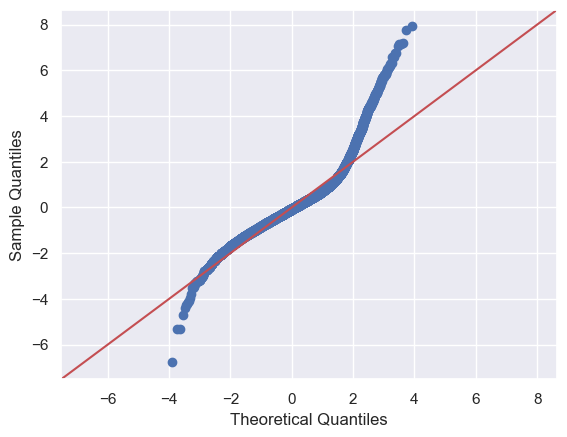

In [90]:
residuals = (y_target - y_preds)
sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True);

Model 3 **does not pass** the normality assumption.

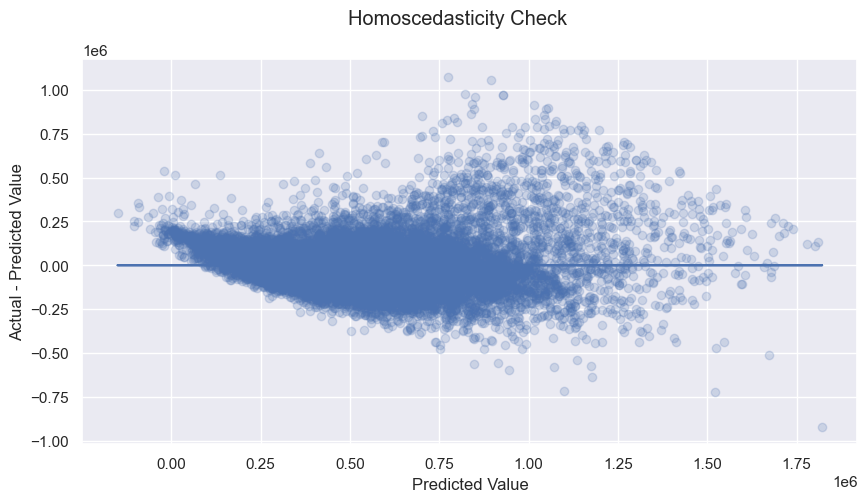

In [91]:
residuals = model3.resid
fig, ax = plt.subplots(figsize=(10,5))
fig.suptitle('Homoscedasticity Check')
ax.scatter(y_preds, residuals, alpha=0.2)
ax.plot(y_preds, [0 for i in range(len(Xc))])
ax.set_xlabel("Predicted Value")
ax.set_ylabel("Actual - Predicted Value");

In [92]:
name = ['F statistic', 'p-value']
test = sms.het_goldfeldquandt(y_target, Xc)
list(zip(name, test))


[('F statistic', 1.1075307651584512), ('p-value', 6.8961646119982e-08)]

Based on the observation of the plot above and the Goldfeld-Quandt test (p-value of 0.000000068961646119982) the baseline model **does pass** the homoscedasticity assumption.

# Model 4
For our fourth model we will be converting the zipcode column with one hot encoing using the get dummies method to see if that will improve our model performance

In [93]:
dummy_df2 = pd.get_dummies(features_df['zipcode'])
features_df = pd.concat([features_df, dummy_df2], axis=1)
features_df.drop('zipcode',axis=1,inplace=True)

In [94]:
y_target = features_df['price']
X_features = features_df.drop('price', axis=1)


Xc = add_constant(X_features)
model4 = sm.OLS(y_target, Xc).fit()
model4.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.839
Model:                            OLS   Adj. R-squared:                  0.839
Method:                 Least Squares   F-statistic:                     1277.
Date:                Tue, 17 Jan 2023   Prob (F-statistic):               0.00
Time:                        13:36:19   Log-Likelihood:            -2.7935e+05
No. Observations:               21380   AIC:                         5.589e+05
Df Residuals:                   21292   BIC:                         5.596e+05
Df Model:                          87                                         
Covariance Type:            nonrobust                                         
=================================================================================
                    coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------
const         -1.422e+07   4.12e+06     -3.454      0.001   -2.23e+07   -6.15e+06
bedrooms      -1.248e+04   1164.599    -10.716      0.000   -1.48e+04   -1.02e+04
bathrooms      1.763e+04   1911.002      9.226      0.000    1.39e+04    2.14e+04
sqft_living      62.3381     10.643      5.857      0.000      41.477      83.199
sqft_lot          0.2917      0.028     10.547      0.000       0.237       0.346
floors        -2.497e+04   2285.099    -10.925      0.000   -2.94e+04   -2.05e+04
waterfront     3.598e+05   1.24e+04     29.014      0.000    3.36e+05    3.84e+05
view           4.769e+04   1273.436     37.453      0.000    4.52e+04    5.02e+04
condition       2.64e+04   1383.275     19.084      0.000    2.37e+04    2.91e+04
grade          5.567e+04   1319.825     42.180      0.000    5.31e+04    5.83e+04
sqft_above       83.8673     10.649      7.876      0.000      62.995     104.740
sqft_basement    23.3549     10.528      2.218      0.027       2.720      43.990
yr_built      -1237.2683     76.012    -16.277      0.000   -1386.258   -1088.279
yr_renovated    661.4513     76.344      8.664      0.000     511.812     811.091
lat            1.438e+05   4.54e+04      3.169      0.002    5.49e+04    2.33e+05
long          -7.534e+04   3.26e+04     -2.311      0.021   -1.39e+05   -1.15e+04
sqft_living15    31.2377      2.120     14.732      0.000      27.081      35.394
sqft_lot15       -0.0530      0.043     -1.226      0.220      -0.138       0.032
month_sold    -2781.3867    252.256    -11.026      0.000   -3275.828   -2286.945
Auburn        -8.375e+05    2.1e+05     -3.995      0.000   -1.25e+06   -4.27e+05
Bellevue      -6.641e+05   2.36e+05     -2.814      0.005   -1.13e+06   -2.02e+05
Black Diamond -5.133e+05   1.37e+05     -3.747      0.000   -7.82e+05   -2.45e+05
Bothell       -5.219e+05   1.44e+05     -3.628      0.000   -8.04e+05    -2.4e+05
Carnation     -5.139e+05   1.38e+05     -3.719      0.000   -7.85e+05   -2.43e+05
Duvall        -5.312e+05    1.4e+05     -3.787      0.000   -8.06e+05   -2.56e+05
Enumclaw       -5.48e+05   1.36e+05     -4.036      0.000   -8.14e+05   -2.82e+05
Fall City     -4.775e+05   1.38e+05     -3.463      0.001   -7.48e+05   -2.07e+05
Federal Way    -7.62e+05   1.89e+05     -4.038      0.000   -1.13e+06   -3.92e+05
Issaquah      -6.231e+05   1.86e+05     -3.358      0.001   -9.87e+05   -2.59e+05
Kenmore       -5.265e+05   1.44e+05     -3.645      0.000    -8.1e+05   -2.43e+05
Kent           -8.93e+05   2.24e+05     -3.986      0.000   -1.33e+06   -4.54e+05
Kirkland      -5.947e+05   1.91e+05     -3.115      0.002   -9.69e+05    -2.2e+05
Maple Valley  -5.371e+05   1.38e+05     -3.902      0.000   -8.07e+05   -2.67e+05
Medina        -1.217e+05   1.43e+05     -0.849      0.396   -4.03e+05    1.59e+05
Mercer Island -3.299e+05   1.42e+05     -2.320   

# Linearity

In [95]:
y_preds = model4.predict(Xc)

fig = px.scatter(x=y_target, y=y_preds , labels={'x': 'Actaual Price', 'y': 'Prediction Price'})
fig.add_shape(
    type="line", line=dict(dash='dash'),
    x0=y_target.min(), y0=y_target.min(),
    x1=y_target.max(), y1=y_target.max()
)
fig.show()

Model 4 **passes** the linearity assumption.

# Normality Check

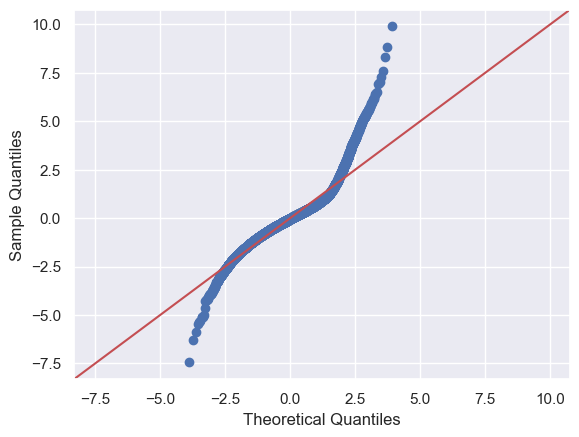

In [96]:
residuals = (y_target - y_preds)
sm.graphics.qqplot(residuals, dist=stats.norm, line='45', fit=True);

Model 4 **does not pass** the normality assumption.

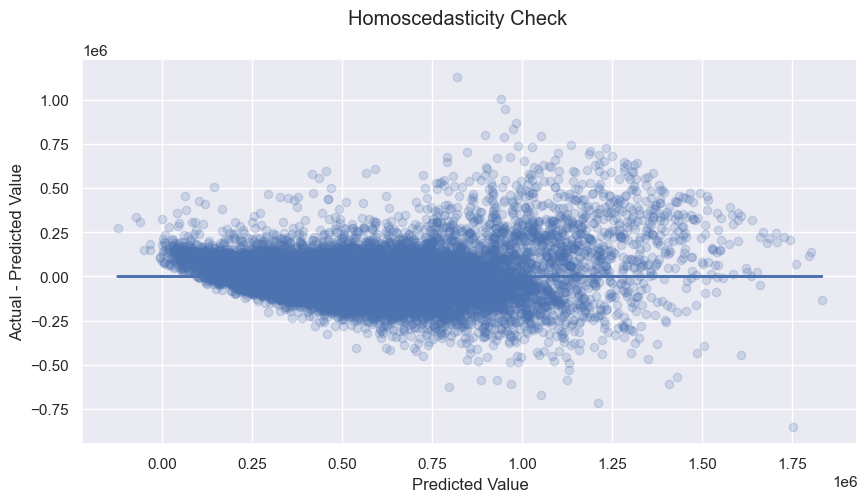

In [97]:
residuals = model4.resid
fig, ax = plt.subplots(figsize=(10,5))
fig.suptitle('Homoscedasticity Check')
ax.scatter(y_preds, residuals, alpha=0.2)
ax.plot(y_preds, [0 for i in range(len(Xc))])
ax.set_xlabel("Predicted Value")
ax.set_ylabel("Actual - Predicted Value");

In [98]:
name = ['F statistic', 'p-value']
test = sms.het_goldfeldquandt(y_target, Xc)
list(zip(name, test))


[('F statistic', 1.074586601163109), ('p-value', 0.00010653382797137484)]

Based on the observation of the plot above and the Goldfeld-Quandt test (p-value of 0.001) the baseline model **does pass** the homoscedasticity assumption.

# Results 
 
Model 4 had the best perfomance with an R-Squared and Adjusted R-Squared of .839.The F-statistic and a very low p-value indicate that the model is statistically significant and that the predictor variables collectively explain a significant amount of the variation in price.

- The coefficient values for the 'condition', 'grade', and 'view' columns represent the average change in the 'price' variable for a unit increase in the respective column.
- The condition of the property was found to have a positive impact on its value, with an incremental increase of 26,400 dollars per unit increase in the condition score, as assessed on a scale of 0 to 4.
- A higher grade level increased the value of a house by 55,670 dollars per unit grade on a scale of 3 to 13
- Properties with a better view had an increase in value of 47,690 dollars per unit increase on a scale form 0 to 4
- Each additional bathroom resulted in an increase of 31,000 dollars in home value.
- Homes located on a waterfront had an increase in value of 359,800 dollars.
- For every 1 sqft increase in living space, the price of the property increases by 62.33 dollars.
- The condition of the property was found to have a positive impact on its value, with an incremental increase of 26,400 dollars per unit increase in the condition score, as assessed on a scale of 0 to 4.
- The coefficient values suggest a negative correlation between the number of bedrooms and floors with the price,it's important to note that this conclusion is most likely incorrect and further analysis is needed.


# Recommendations
1. Building grade is a crucial factor when it comes to real estate, and it was found to be the highest positively correlated feature with price in our analysis. Therefore, when renovating and developing homes, it is important to prioritize the use of the best materials. This will increase the chances of the home selling for the highest possible price.


2. When it comes to renovating homes, it is advisable to aim for distressed homes that are in poor condition. Improving the condition of these homes from poor to good or very good can result in an increase in value by as much as 79,200 to 105,600 dollars.


3. For new developments homes it is recommended to acquire homes that are located on a waterfront but have a lower building grade. Homes on a waterfront are found to sell for 359,800 dollars more than homes that are not on a waterfront. When developing these homes, it is recommended to aim for luxury or mansion grades.




# Limitations and Further Analysis
   Our final model demonstrated an accuracy rate of 83.9% on the data set utilized. While this level of accuracy is sufficient to generate observations and insights, it is not appropriate to arrive at any definitive conclusions at this time. Our coefficient scores for bedrooms and floors were negative, which warrants further investigation.O ur visualizations of various variables allowed us to discern their relationship with the target variable, price. Based on our observations, we believe that an increase in the number of floors and bedrooms would not have a negative impact on the price of a property, but rather the opposite. However, it is possible that this conclusion may be affected by the limited scope of our data, and incorporating additional data into the model could provide further insight. Our future analyses should include incorporating both recent and historical data. The real estate industry is known for its cyclical nature, however, we were unable to detect any statistically significant correlation with the date of sale. This is likely due to the limited scope of our data, which only covered a one-year period. In general, home sales tend to increase during the summer months and decrease during the winter. Therefore, our future analyses should also consider the impact of seasonality on real estate trends.

### Use Alternative data:
 Alternative data can provide valuable insights into the performance and potential of real estate investments. An example of some of the data we should consider using includes:


**Demographic data** : This type of data can provide information about the age, income, and education level of people in a particular area, which can be useful for identifying areas that are likely to experience population growth in the future.

**Social media data**: Platforms like Twitter and Instagram can provide insight into what people are saying about a particular area, which can be useful for identifying areas that are becoming trendy or experiencing a decline in popularity.

**Satellite data**: Imagery and data captured by satellites can be used to track changes in land use, such as the construction of new buildings or the expansion of roads, which can provide insight into the potential for development in a particular area.


### Use Different models:
There are several alternative methods to the ordinary least squares (OLS) method that can be used for modeling real estate data, depending on the specific requirements of the analysis and the nature of the data. Here are a few examples:

1. **Decision tree models**: Decision trees are a popular method for modeling real estate data because they can handle both continuous and categorical variables, and they can also handle non-linear relationships. They can be used to make predictions about the price of a property based on its features and characteristics.

2. **Random Forest models**: Random Forest is an extension of decision trees. It is a collection of decision trees where a random subset of features is used at each split. The final prediction is an average of all the decision trees. They are often more accurate than decision trees.

3. **Gradient Boosting models**: Gradient Boosting is an ensemble method that combines multiple weak models to create a more accurate and robust model. They work well when there are non-linear relationships in the data.

4. **Support Vector Regression (SVR)**: SVR is a type of algorithm that can be used for both linear and non-linear regression problems. It can handle non-linear relationships by mapping the input data into a higher dimensional space where a linear boundary can be drawn between the classes.

5. **Neural Network models**: Neural networks are a type of algorithm that can be used for both linear and non-linear regression problems. They are particularly useful when there are a large number of predictor variables or when the relationships between the predictor variables and the response variable are complex.

### Use One Hot Encoding on  Condition, Grade, View Columnns:
In our final model, we utilized one-hot encoding for the City and zipcode columns, but did not utilize the same method for the Condition, Grade, and View columns. Upon further evaluation, it is plausible that the model performance could be enhanced by implementing one-hot encoding for these variables as well. However, we did not use one-hot encoding, instead, we transformed the categorical variables into numerical ones. This approach was selected to facilitate the modeling process.

**Condition**: 

{'Poor': 0, 'Fair': 1, 'Average': 2,'Good':3, 'Very Good':4}

**Grade**:

{'3 Poor': 3, '4 Low': 4, '5 Fair': 5, '6 Low Average': 6, '7 Average': 7,'8 Good': 8, '9 Better': 9, '10 Very Good': 10, '11 Excellent': 11, '12 Luxury': 12,'13 Mansion': 13}


**View**: {'NONE': 0, 'FAIR': 1, 'AVERAGE': 2, 'GOOD': 3, 'EXCELLENT': 4}

### Adressing Normality:

Our data failed to pass the normality test, indicating that it did not conform to a normal distribution. In light of this, we elected not to transform the data using a logarithmic function, in order to maintain the accuracy of the relationships between our variables. As a next step, we recommend utilizing non-parametric statistical methods, such as the Wilcoxon rank-sum test, the Kruskal-Wallis test, and the Wilcoxon signed-rank test, which are suitable for data that does not follow a normal distribution.

1. **The Wilcoxon rank-sum test** (also known as the Mann-Whitney test) is a non-parametric test used to determine if there is a significant difference between the medians of two groups of data. It is used to compare two independent groups, and it does not assume that the data is normally distributed.

2. **The Kruskal-Wallis test** is a non-parametric test used to determine if there is a significant difference between the medians of two or more groups of data. It is used to compare more than two independent groups and it does not assume that the data is normally distributed.

3. **The Wilcoxon signed-rank test** is a non-parametric test used to determine if there is a significant difference between the medians of two related groups of data. It is used to compare two dependent groups and it does not assume that the data is normally distributed.



